# Calibration curve

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

In [ ]:
def plot_calibration_curve(preds, title = ''):
    """
    preds --- array of probabilities
    """
    plt.figure(figsize=(9,5))
    plt.title(title, fontsize=13)
    plt.grid(True)
    plt.ylabel('Доля объектов',  fontsize=10)
    plt.xlabel('Порог',  fontsize=10)
    plt.plot([0, 1], [0, 1], linestyle='--')

    bin_middle_points = []
    bin_real_ratios = []
    n_bins = 100
    for i in range(n_bins + 1):
        x = i / n_bins

        bin_middle_points.append(x)

        y = len(np.where(preds <= x)[0]) / len(preds)
        bin_real_ratios.append(y)


    plt.plot(bin_middle_points, bin_real_ratios)
    return bin_middle_points, bin_real_ratios

In [ ]:
preds = np.array([0.01, 0.05, 0.12, 0.2, 0.1, 0.2, 0.5, 0.7, 0.9, 0.96, 0.95, 0.99])

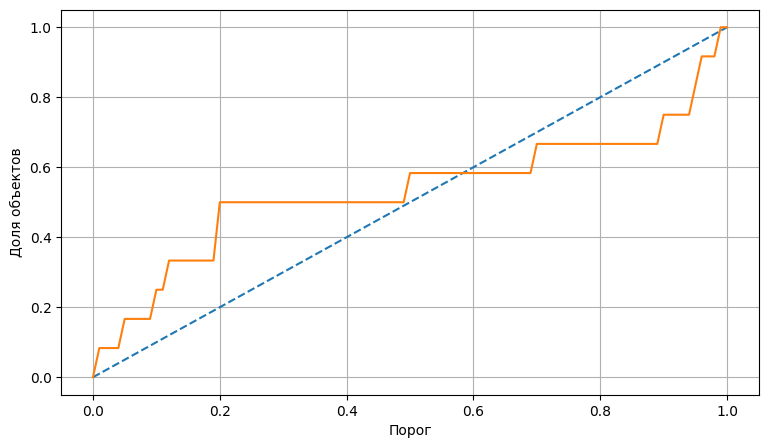

In [ ]:
x, y = plot_calibration_curve(preds)

In [ ]:
preds_new = np.zeros_like(preds)

for i in range(len(preds)):
    thr = preds[i]
    x = len(np.where(preds <= thr)[0]) / len(preds)
    preds_new[i] = x

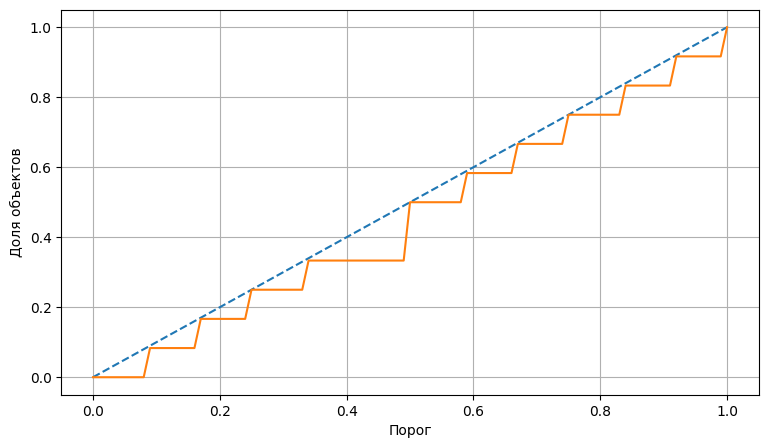

In [ ]:
x, y = plot_calibration_curve(preds_new)

In [ ]:
preds = np.sort(preds)
preds_new = np.sort(preds_new)

In [ ]:
preds, preds_new

(array([0.01, 0.05, 0.1 , 0.12, 0.2 , 0.2 , 0.5 , 0.7 , 0.9 , 0.95, 0.96,
        0.99]),
 array([0.08333333, 0.16666667, 0.25      , 0.33333333, 0.5       ,
        0.5       , 0.58333333, 0.66666667, 0.75      , 0.83333333,
        0.91666667, 1.        ]))

In [ ]:
preds_test = np.array([0.1, 0.2, 0.3, 0.4, 0.5, 0.7, 0.9])

def calibration(preds_test, preds, preds_true):

    preds_test_new = np.zeros_like(preds_test)

    for i in range(len(preds_test)):

        x = preds_test[i]
        idx = 0
        while preds[idx] < x:
            idx += 1

        preds_test_new[i] = preds_true[idx]

    return preds_test_new

In [ ]:
calibration(preds_test, preds, preds_new)

array([0.25      , 0.5       , 0.58333333, 0.58333333, 0.58333333,
       0.66666667, 0.75      ])

# siam

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
cd drive/MyDrive/Colab\ Notebooks/mest

/content/drive/MyDrive/Colab Notebooks/mest


In [3]:
!pip install -q hydra-core==1.3

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 153.8/153.8 kB 2.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.5/79.5 kB 8.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.0/117.0 kB 4.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done


In [4]:
import json, os
import matplotlib.pyplot as plt

from torchvision import datasets, models, transforms
from time import time
import torch
import torch.nn as nn
from torch.utils.data import DataLoader, Dataset
from torchvision import models, transforms
from torchvision.transforms import v2
from PIL import Image, ImageOps
from tqdm import tqdm
from functools import partial
from torchvision.utils import save_image

from sklearn.metrics import accuracy_score
import matplotlib.pyplot as plt
import torch
import os, json, cv2, re
import numpy as np
import random
import pickle

from src.dataset import My_Dataset, TripletDataset, Emb_Dataset, Pipeline
from src.functions import number_of_parameters, seed_everything
from src.dataset_fun import split_dataset
from src import siamese, classifier
from src.classifier import get_predictions
from src.train import train, load_logs, load_model, save_logs, load_logs
from src.functions import confusion_matrix, distribution, create_model, dir_paths
from src.show_fun import show_result, show_images, plot_transformed_images, graph_logs

from src.commands import hydra_config, show_CONF, config_model
from src.commands import common_train, load_best_model #, pos_neg_dataset

In [5]:
CONF1 = hydra_config("config (siam).yaml")
show_CONF(CONF1)

{
        "seed": 42,
        "device": "cpu",
        "save_path": "checkpoints",
        "dataset": {
                "data_pos": "bin/1res",
                "data_neg": "bin/0res",
                "threshold": 0.95
        },
        "loader": {
                "batch_size": 64
        },
        "siamese": {
                "n_epochs": 30,
                "learning_rate": 0.0003,
                "margin": 9,
                "path_model": "checkpoints/siamese",
                "path_log": "checkpoints/siamese/siamese.pickle"
        },
        "classifier": {
                "n_epochs": 30,
                "learning_rate": 0.0003,
                "path_model": "checkpoints/classifier",
                "path_log": "checkpoints/classifier/classifier.pickle"
        }
}


In [6]:
# CONF1.dataset.threshold = 0.95

In [7]:
def pos_neg_dataset(CONF, transform1, transform2, pos_aug, neg_aug, data_pos, data_neg):

    pos_dataset = My_Dataset(
        "pos",
        data_pos,
        augmentation=pos_aug,
        transform=transform1,
        threshold=CONF.dataset.threshold,
        seed=CONF.seed,
        deterministic=True,
    )
    print(f"Positive dataset: {len(pos_dataset)}    ({pos_dataset.real_len})")

    neg_dataset = My_Dataset(
        "neg",
        data_neg,
        augmentation=neg_aug,
        transform=transform2,
        threshold=CONF.dataset.threshold,
        seed=CONF.seed,
        deterministic=True,
    )
    print(f"Negative dataset: {len(neg_dataset)}    ({neg_dataset.real_len})")

    return pos_dataset, neg_dataset

In [ ]:
# plot_transformed_images(dir_paths("bin/1resRB"), transform, n=0)

In [ ]:
# pos_dataset_train[4]

In [8]:
transform1 = transforms.Compose(
    [
            v2.Pad(padding=150, fill=255),
            transforms.RandomCrop(300),
            # transforms.CenterCrop(224),
            transforms.RandomPerspective(distortion_scale=0.3, p=0.5, fill=255),
            transforms.ToTensor(),
    ])

transform2 = transforms.Compose(
    [
            v2.Pad(padding=150, fill=255),
            transforms.RandomCrop(300),
            transforms.ToTensor(),
    ])

pos_dataset_train, neg_dataset_train = pos_neg_dataset(CONF1, transform1, transform2,
                                                       pos_aug=40, neg_aug=5,
                                           data_pos="bin/1resLT", data_neg="bin/0resLT")

pos_dataset_test, neg_dataset_test = pos_neg_dataset(CONF1, transform1, transform2,
                                                     pos_aug=40, neg_aug=5,
                                           data_pos="bin/1resRB", data_neg="bin/0resRB")


# Доля белого у bin/0resLT/37-16.png           больше 0.95 (0.952144)!!!
# Доля белого у bin/0resLT/37-6.png            больше 0.95 (0.950311)!!!

# Доля белого у bin/0resRB/142-17.png          больше 0.95 (0.958911)!!!
# Доля белого у bin/0resRB/142-28.png          больше 0.95 (0.983722)!!!
# Доля белого у bin/0resRB/142-9.png           больше 0.95 (0.979556)!!!
# Доля белого у bin/0resRB/2348-23.png         больше 0.95 (0.9539)!!!
# Доля белого у bin/0resRB/2348-40.png         больше 0.95 (0.968433)!!!
# Доля белого у bin/0resRB/2348-53.png         больше 0.95 (0.966256)!!!
# Доля белого у bin/0resRB/68-22.png           больше 0.95 (0.975178)!!!

# Positive dataset: 1000    (25)
# Доля белого у bin/0resLT/37-6.png            больше 0.95 (0.952622) !!!
# Доля белого у bin/0resLT/37-6.png            больше 0.95 (0.950422) !!!
# Доля белого у bin/0resLT/68-9.png            больше 0.95 (0.950444) !!!

Positive dataset: 1000    (25)
Доля белого у bin/0resLT/37-6.png            больше 0.95 (0.952622) !!!
Доля белого у bin/0resLT/37-6.png            больше 0.95 (0.950422) !!!
Доля белого у bin/0resLT/68-9.png            больше 0.95 (0.950444) !!!
Negative dataset: 1105    (221)
Positive dataset: 1000    (25)
Negative dataset: 1075    (215)


In [9]:
siam = models.resnet18(weights=models.ResNet18_Weights.DEFAULT).to(CONF1.device)
num_classes = 1000
num_non_freeze = 513000
seed_everything(CONF1.seed)
siam = create_model(siam, num_non_freeze, num_classes, verbose=False).to(CONF1.device)
print(f"num parameters ResNet = {number_of_parameters(siam)}")

Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /root/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth
100%|██████████| 44.7M/44.7M [00:00<00:00, 87.1MB/s]


num parameters ResNet = 513000


In [10]:
load_best_model(CONF1, siam, None, None, kind="siam")

load_best_model:
LOGS:
# 2024-06-22 12:48:09 Epoch 29 train/val: loss 0.47653/2.52643, acc: 99.000%/ 90.750%


train: started, kind = 'siam'
# 2024-06-21 10:06:18 Epoch  1 train/val: loss 3.06314/4.07257, acc: 93.450%/ 86.950%
# 2024-06-21 10:08:21 Epoch  2 train/val: loss 2.10424/3.52123, acc: 95.450%/ 86.950%
# 2024-06-21 10:10:24 Epoch  3 train/val: loss 1.66292/3.25311, acc: 96.362%/ 88.150%
# 2024-06-21 10:12:27 Epoch  4 train/val: loss 1.31504/2.99605, acc: 97.237%/ 89.250%
# 2024-06-21 10:14:29 Epoch  5 train/val: loss 1.14701/2.83905, acc: 97.763%/ 90.050%
# 2024-06-21 10:16:33 Epoch  6 train/val: loss 1.07783/2.91817, acc: 98.000%/ 89.200%
# 2024-06-21 10:18:35 Epoch  7 train/val: loss 0.98886/2.78324, acc: 98.075%/ 90.250%
# 2024-06-21 10:20:39 Epoch  8 train/val: loss 0.87057/2.71741, acc: 98.487%/ 90.500%
# 2024-06-21 10:22:41 Epoch  9 train/val: loss 0.88479/2.79025, acc: 98.425%/ 89.950%
# 2024-06-21 10:24:44 Epoch 10 train/val: loss 0.83407/2.77619, acc: 98.450%/ 89.800%
# 2024-06-21 10:26:47 Epoch 11 train/val: loss 0.79861/2.74405, acc: 98.500%/ 89.700%
# 2024-06-21 10:28:51 Ep

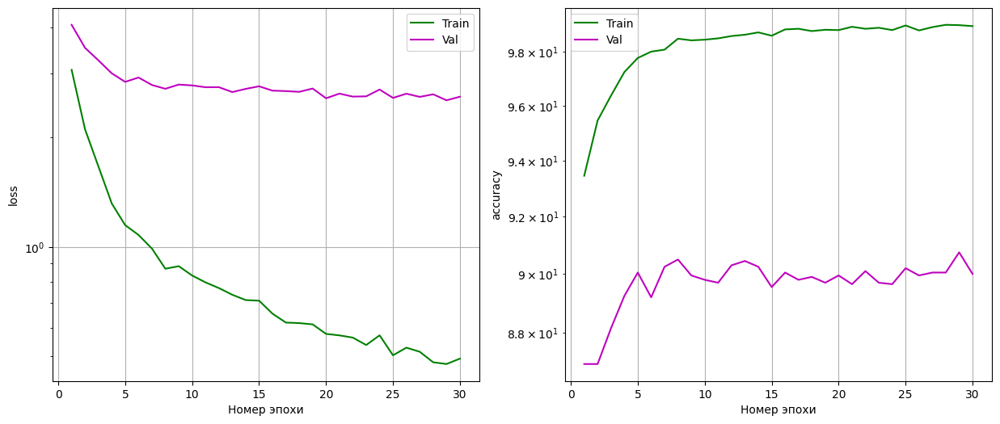

In [ ]:
dataset_tri_train = TripletDataset(
        pos_dataset_train, neg_dataset_train, required_len=8000, deterministic=True, seed=CONF1.seed
    )

dataset_tri_test = TripletDataset(
        pos_dataset_test, neg_dataset_test, required_len=2000, deterministic=True, seed=CONF1.seed
    )
seed_everything(CONF1.seed)
# train_dataset, test_dataset = split_dataset(dataset_tri)
common_train(CONF1, siam, dataset_tri_train, dataset_tri_test, kind="siam")
load_best_model(CONF1, siam, dataset_tri_train, dataset_tri_test, kind="siam")
logs = load_logs(CONF1.siamese.path_log)
graph_logs(logs, num=0)

In [11]:
cl = nn.Sequential(nn.Linear(num_classes, 512), nn.ReLU(), nn.Linear(512, 2)).to(
    CONF1.device
)

# dataset_train = torch.utils.data.ConcatDataset([pos_dataset_train, neg_dataset_train])
# dataset_emb_train = Emb_Dataset(siam, dataset_train, CONF1.device)

# dataset_test = torch.utils.data.ConcatDataset([pos_dataset_test, neg_dataset_test])
# dataset_emb_test = Emb_Dataset(siam, dataset_test, CONF1.device)


load_best_model(CONF1, cl, None, None, kind="cl")

load_best_model:
LOGS:
# 2024-06-22 12:48:13 Epoch 20 train/val: loss 0.00190/0.07771, acc:100.000%/ 97.639%


num parameters = 513538
train: started, kind = 'cl'
# 2024-06-21 11:07:23 Epoch  1 train/val: loss 0.06187/0.10321, acc: 98.052%/ 96.193%
# 2024-06-21 11:07:46 Epoch  2 train/val: loss 0.05222/0.08837, acc: 97.910%/ 96.819%
# 2024-06-21 11:08:08 Epoch  3 train/val: loss 0.03434/0.10709, acc: 99.240%/ 95.663%
# 2024-06-21 11:08:30 Epoch  4 train/val: loss 0.02298/0.07672, acc: 99.430%/ 97.012%
# 2024-06-21 11:08:52 Epoch  5 train/val: loss 0.01871/0.07435, acc: 99.525%/ 97.108%
# 2024-06-21 11:09:15 Epoch  6 train/val: loss 0.01414/0.09193, acc: 99.810%/ 96.193%
# 2024-06-21 11:09:37 Epoch  7 train/val: loss 0.01309/0.07570, acc: 99.715%/ 97.398%
# 2024-06-21 11:09:59 Epoch  8 train/val: loss 0.00824/0.07693, acc: 99.905%/ 97.108%
# 2024-06-21 11:10:21 Epoch  9 train/val: loss 0.00836/0.08929, acc: 99.810%/ 96.386%
# 2024-06-21 11:10:43 Epoch 10 train/val: loss 0.00520/0.07379, acc: 99.952%/ 97.157%
# 2024-06-21 11:11:05 Epoch 11 train/val: loss 0.00486/0.07800, acc: 99.952%/ 97.108%
# 

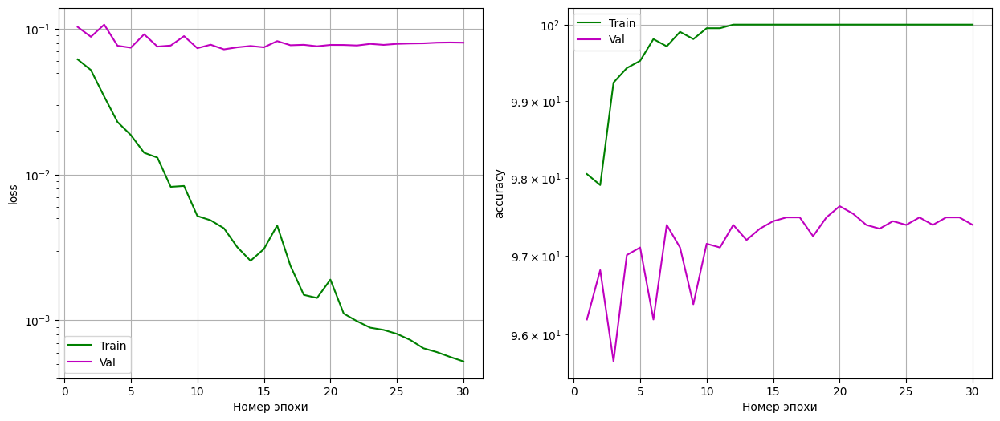

In [ ]:
cl = nn.Sequential(nn.Linear(num_classes, 512), nn.ReLU(), nn.Linear(512, 2)).to(
    CONF1.device
)
num_param = number_of_parameters(cl)
print(f"num parameters = {num_param}")

dataset_train = torch.utils.data.ConcatDataset([pos_dataset_train, neg_dataset_train])
dataset_emb_train = Emb_Dataset(siam, dataset_train, CONF1.device)

dataset_test = torch.utils.data.ConcatDataset([pos_dataset_test, neg_dataset_test])
dataset_emb_test = Emb_Dataset(siam, dataset_test, CONF1.device)

seed_everything(CONF1.seed)
# train_dataset, test_dataset = split_dataset(dataset_emb)

common_train(CONF1, cl, dataset_emb_train, dataset_emb_test, kind="cl")
load_best_model(CONF1, cl, dataset_emb_train, dataset_emb_test, kind="cl")
logs = load_logs(CONF1.classifier.path_log)
graph_logs(logs, num=0)

model = Pipeline(siam, cl, CONF1)

In [12]:
model = Pipeline(siam, cl, CONF1)

In [ ]:
_, y_train, _, y_prob_train = get_predictions(model, dataset_train,
                                            CONF1.loader.batch_size, CONF1.device)

_, y_test, _, y_prob_test = get_predictions(model, dataset_test,
                                            CONF1.loader.batch_size, CONF1.device)

In [18]:
# torch.save(y_train, 'y_train.pt')
# torch.save(y_prob_train, 'y_prob_train.pt')
# torch.save(y_test, 'y_test.pt')
# torch.save(y_prob_test, 'y_prob_test.pt')

y_train = torch.load("y_train.pt")
y_prob_train = torch.load("y_prob_train.pt")
y_test = torch.load("y_test.pt")
y_prob_test = torch.load("y_prob_test.pt")

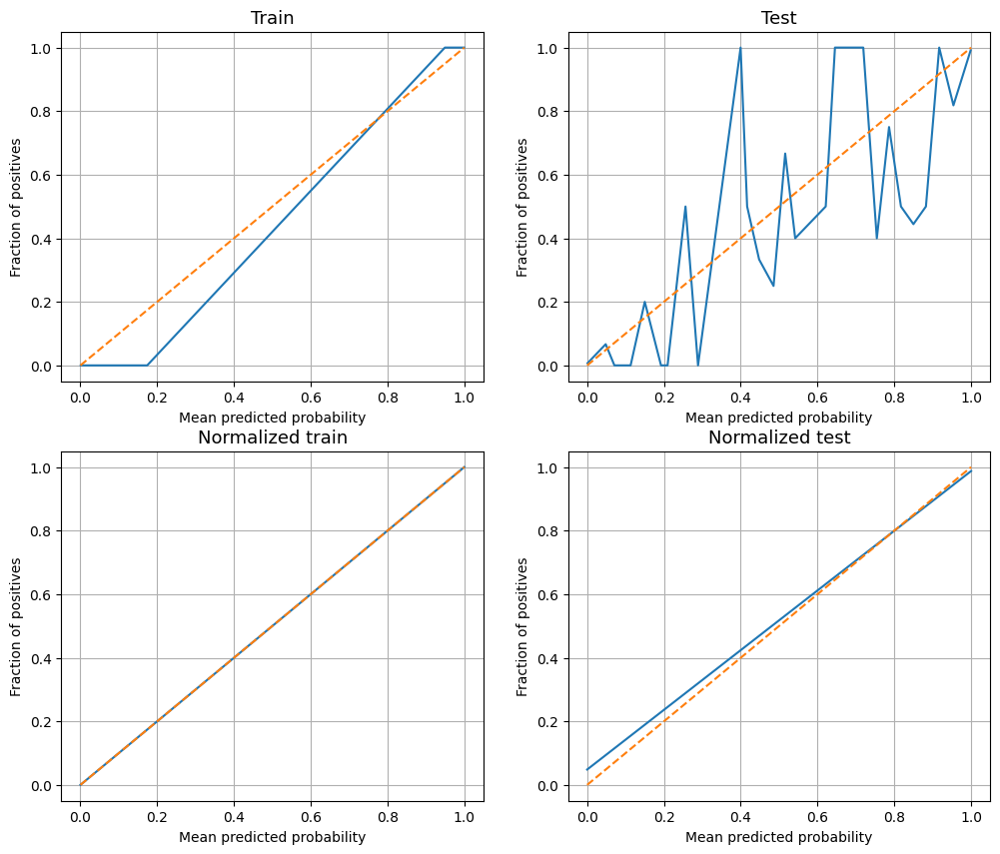

In [19]:
from sklearn.calibration import calibration_curve

def plot_cal_curve(y_test, y_prob, bin, title = ''):
    plt.title(title, fontsize=13)
    plt.grid(True)
    plt.ylabel('Fraction of positives',  fontsize=10)
    plt.xlabel('Mean predicted probability',  fontsize=10)

    proportion, meanprob = calibration_curve(y_test, y_prob, n_bins=bin)
    # print(proportion, meanprob)
    plt.plot(meanprob, proportion)
    plt.plot([0, 1], [0, 1], linestyle='--')


class HistogramBinner:
    def __init__(self, n_bins, normalize=True):
        self.bins = np.linspace(0, 1, n_bins + 1)
        self.n_bins = n_bins
        self.thetas = None
        self.normalize = normalize

    def fit(self, y_true, y_conf):
        y_true = y_true.numpy()
        y_conf = y_conf.numpy()
        if self.normalize:
            y_conf = (y_conf - y_conf.min()) / (y_conf.max() - y_conf.min())
        thetas = []
        for l, r in zip(self.bins, self.bins[1:]):
            y = y_true[(l <= y_conf) & (y_conf <= r)]
            if len(y):
                thetas.append(y.mean())
            else:
                thetas.append(0)
        thetas.append(thetas[-1])
        self.thetas = np.array(thetas)
        return thetas

    def transform(self, y_conf):
        y_conf = y_conf.numpy()
        if self.normalize:
            y_conf = (y_conf - y_conf.min()) / (y_conf.max() - y_conf.min())
        res = self.thetas[np.digitize(y_conf, self.bins) - 1]
        return torch.from_numpy(res)

bin = 30
hb = HistogramBinner(bin)
hb.fit(y_train, y_prob_train)
y_prob_train_new = hb.transform(y_prob_train)
y_prob_test_new = hb.transform(y_prob_test)

plt.figure(figsize=(12, 10))
plt.subplot(2, 2, 1)
plot_cal_curve(y_train, y_prob_train, bin, title="Train")
plt.subplot(2, 2, 2)
plot_cal_curve(y_test, y_prob_test, bin, title="Test")

plt.subplot(2, 2, 3)
plot_cal_curve(y_train, y_prob_train_new, bin, title="Normalized train")
plt.subplot(2, 2, 4)
plot_cal_curve(y_test, y_prob_test_new, bin, title="Normalized test")
plt.savefig('{}.{}'.format('norm', 'pdf'), bbox_inches='tight')
plt.show()

In [ ]:
def dist(pos_dataset, neg_dataset):
    dataset= torch.utils.data.ConcatDataset([pos_dataset, neg_dataset])


    X, y_true1, y_pred1, y_prob = get_predictions(model, dataset,
                                            CONF1.loader.batch_size, CONF1.device)
    print("Total: ", accuracy_score(y_pred1, y_true1))
    print(confusion_matrix(y_true1, y_pred1))

    X, y_true2, y_pred2, y_prob2 = get_predictions(model, pos_dataset,
                                                CONF1.loader.batch_size, CONF1.device)
    print("Positive: ", accuracy_score(y_pred2, y_true2))

    plt.figure(figsize=(15, 6))
    plt.subplot(1, 2, 1)
    plt.title("Positive")
    distribution(y_prob2)

    X, y_true3, y_pred3, y_prob3 = get_predictions(model, neg_dataset,
                                                CONF1.loader.batch_size, CONF1.device)
    print("Negative: ", accuracy_score(y_pred3, y_true3))
    plt.subplot(1, 2, 2)
    plt.title("Negative")
    distribution(y_prob3)
    plt.show()

In [16]:
_, y_true2, y_pred2, y_prob2 = get_predictions(model, pos_dataset_test,
                                                CONF1.loader.batch_size, CONF1.device)

_, y_true3, y_pred3, y_prob3 = get_predictions(model, neg_dataset_test,
                                                CONF1.loader.batch_size, CONF1.device)

In [23]:
def norm_dist(pos_dataset, neg_dataset):
    dataset= torch.utils.data.ConcatDataset([pos_dataset, neg_dataset])

    # X, y_true1, y_pred1, y_prob = get_predictions(model, dataset,
    #                                         CONF1.loader.batch_size, CONF1.device)
    # print("Total: ", accuracy_score(y_pred1, y_true1))
    # print(confusion_matrix(y_true1, y_pred1))

    # _, y_true2, y_pred2, y_prob2 = get_predictions(model, pos_dataset,
    #                                             CONF1.loader.batch_size, CONF1.device)
    # print("Positive: ", accuracy_score(y_pred2, y_true2))

    plt.figure(figsize=(12, 10))
    plt.subplot(2, 2, 1)
    plt.title("Positive")
    distribution(y_prob2)
    xlim = (-0.2, 1.2)
    ylim = (0, 20)
    plt.xlim(xlim)
    # plt.ylim(ylim)

    # _, y_true3, y_pred3, y_prob3 = get_predictions(model, neg_dataset,
    #                                             CONF1.loader.batch_size, CONF1.device)
    print("Negative: ", accuracy_score(y_pred3, y_true3))
    plt.subplot(2, 2, 2)
    plt.title("Negative")
    distribution(y_prob3)
    plt.xlim(xlim)
    # plt.ylim(ylim)


    y_prob22 = hb.transform(y_prob2)
    y_prob33 = hb.transform(y_prob3)

    plt.subplot(2, 2, 3)
    plt.title("Normalized positive")
    distribution(y_prob22)
    plt.xlim(xlim)
    # plt.ylim(ylim)

    plt.subplot(2, 2, 4)
    plt.title("Normalized negative")
    distribution(y_prob33)
    plt.xlim(xlim)
    # plt.ylim(ylim)

    plt.savefig('{}.{}'.format('dist', 'pdf'), bbox_inches='tight')
    plt.show()

Negative:  0.9683720930232558


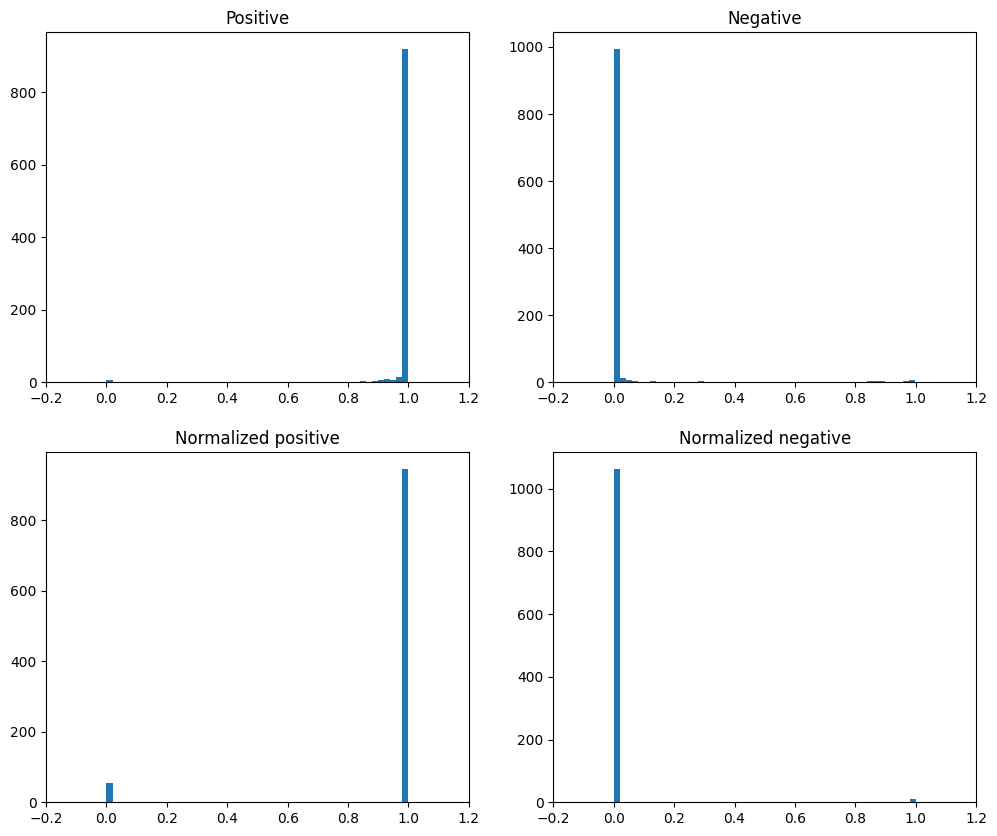

In [24]:
norm_dist(pos_dataset_test, neg_dataset_test)

Total:  1.0


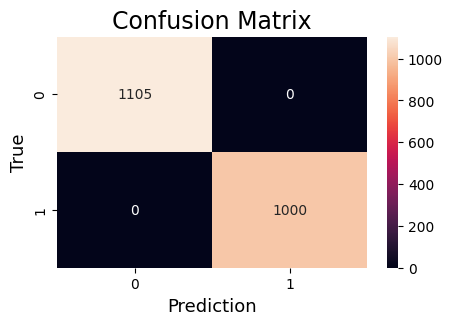

[[1105    0]
 [   0 1000]]
Positive:  1.0
Negative:  1.0


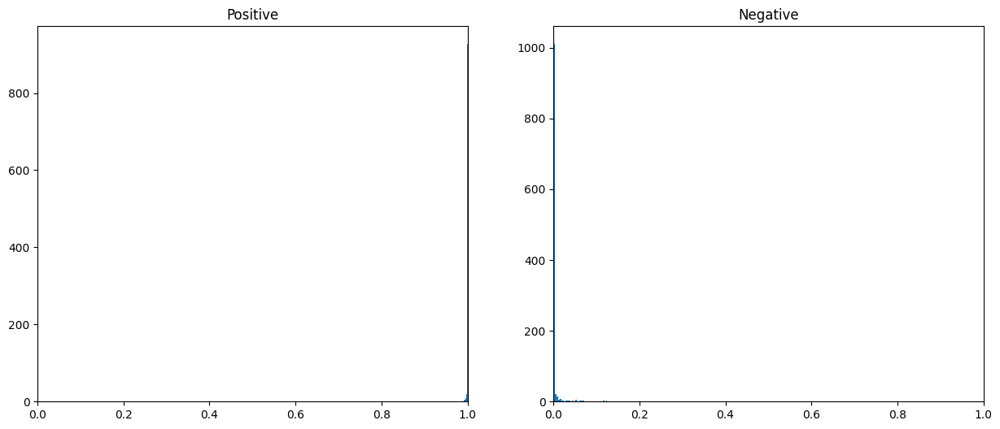

Total:  0.9763855421686747


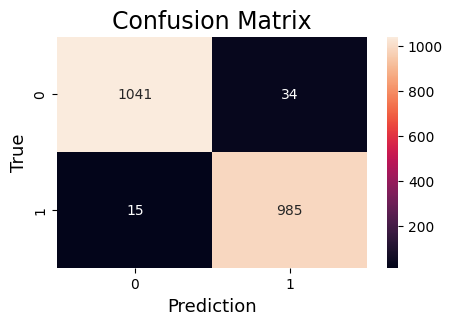

[[1041   34]
 [  15  985]]
Positive:  0.985
Negative:  0.9683720930232558


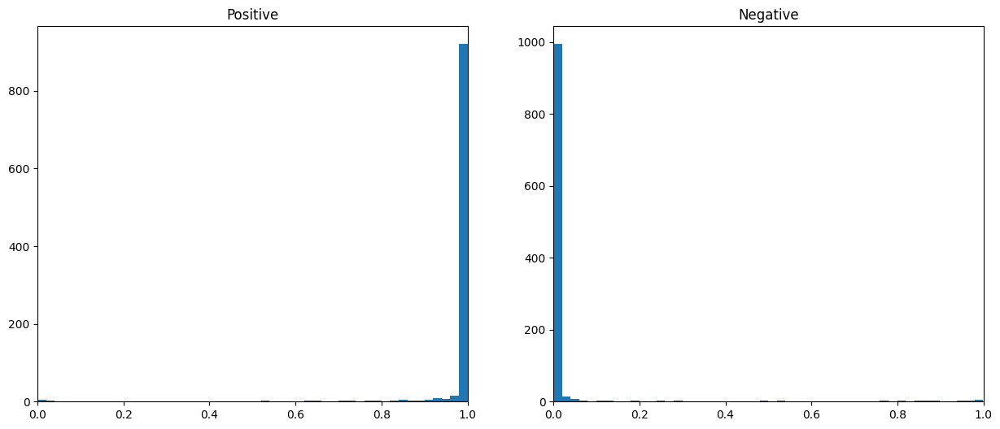

In [ ]:
dist(pos_dataset_train, neg_dataset_train)
dist(pos_dataset_test, neg_dataset_test)

In [ ]:
X, y_true, y_pred, y_prob, indices = show_result(model, pos_dataset_test, 0,
                                   CONF1.loader.batch_size, CONF1.device,
                                   greater = True, col = 30,
                                   sort = True, norm = hb)

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
X, y_true, y_pred, y_prob, indices = show_result(model, neg_dataset_test, 0,
                                   CONF1.loader.batch_size, CONF1.device,
                                   greater = True, col = 30,
                                   sort = True, norm = hb)

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
transform = transforms.Compose(
    [
            transforms.RandomCrop(300),
            # transforms.CenterCrop(224),
            # transforms.RandomPerspective(distortion_scale=0.3, p=0.5, fill=255),
            transforms.ToTensor(),
    ])

pos_dataset, neg_dataset = pos_neg_dataset(CONF1, transform, transform, pos_aug=1, neg_aug=1,
                                           data_pos="bin/1res", data_neg="bin/0res")

Positive dataset: 25    (25)
Negative dataset: 222    (222)


In [ ]:
X, y_true, y_pred, y_prob, indices = show_result(model, neg_dataset, -1,
                                   CONF1.loader.batch_size, CONF1.device,
                                   greater = True, col = 30,
                                   sort = True, norm = hb)

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
X, y_true, y_pred, y_prob, indices = show_result(model, neg_dataset, 2,
                                   CONF1.loader.batch_size, CONF1.device,
                                   greater = False, col = 30,
                                   sort = True, norm = hb)

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
X, y_true, y_pred, y_prob, indices = show_result(model, pos_dataset, 2,
                                   CONF1.loader.batch_size, CONF1.device,
                                   greater = False, col = None,
                                   sort = True, norm = hb)

Output hidden; open in https://colab.research.google.com to view.

## Result

In [ ]:
def show_images(images, labels, n=4):
    num_pic = min(len(images), n)
    width, height = 4, num_pic // 4 + 1

    for i in range(num_pic):
        if i % width == 0:
            plt.figure(figsize=(5 * width, 6))

        plt.subplot(1, width, i % width + 1)

        img = images[i]
        img = np.transpose(img, (1, 2, 0))

        plt.imshow(img)
        # if torch.is_tensor(labels[i]):
        #     title = labels[i].numpy()
        # else:
        #     title = labels[i]
        # x, col = np.unique(img.max(dim=2)[0], return_counts=True)
        # ones = col[np.where(x == 1)[0]][0]
        # dol = ones / col.sum()

        number = labels[i]
        # number = "    ".join([str(_) for _ in labels[i]])
        title = (
            f"№ {int(number[0])}:   {round(number[1], 5)}"  # , доля белого - {dol:.4f}"
        )

        plt.title(title)

        if i % width == width - 1:
            plt.tight_layout()
            plt.show()

    plt.show()

In [ ]:
def show_best(images_dir, model,
    dataset,
    aug,
    batch_size,
    device):

    X, y_true, y_pred, y_prob = get_predictions(model, dataset, batch_size, device)
    y_prob = hb.transform(y_prob)

    y_prob = y_prob.reshape(-1, aug)
    print(y_prob.shape)
    y_prob = y_prob.max(dim=1).values
    _, indices = torch.sort(y_prob, descending=True)
    print(indices.shape)

    files_names = sorted(os.listdir(images_dir))
    image_paths = [os.path.join(images_dir, i) for i in files_names]

    X = []
    for name in image_paths:
        image = Image.open(name)
        transformed_image = transforms.ToTensor()(image)
        X.append(transformed_image)

    X_sort = []
    for i in indices:
        X_sort.append(X[i])

    labels = np.stack((indices, y_prob[indices]), axis=1)
    # labels = indices
    show_images(X_sort, labels, n = len(X))

In [ ]:
transform = transforms.Compose(
    [
            transforms.RandomCrop(300),
            transforms.CenterCrop(224),
            # transforms.RandomPerspective(distortion_scale=0.5, p=0.5, fill=255),
            transforms.ToTensor(),
    ])

pos_dataset, neg_dataset = pos_neg_dataset(CONF1, transform, transform, pos_aug=1, neg_aug=10,
                                           data_pos="bin/1res", data_neg="bin/0res")

Positive dataset: 25    (25)
Negative dataset: 2220    (222)


torch.Size([222, 10])
torch.Size([222])


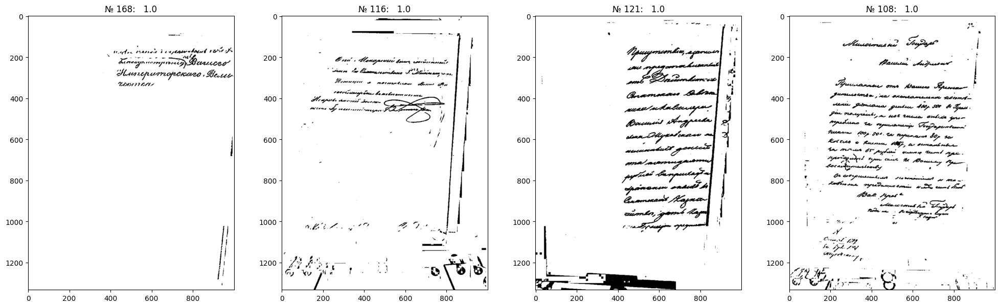

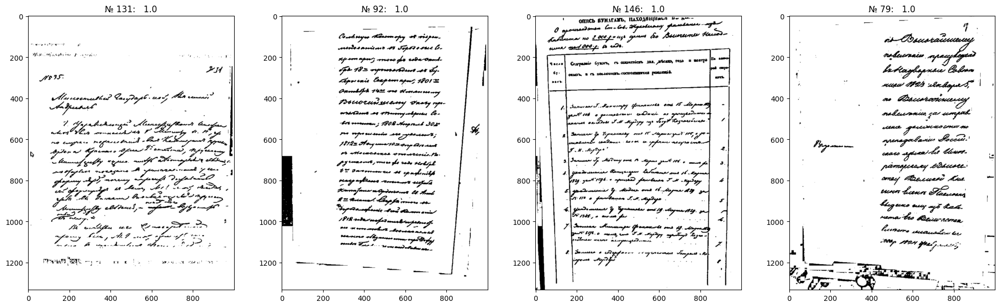

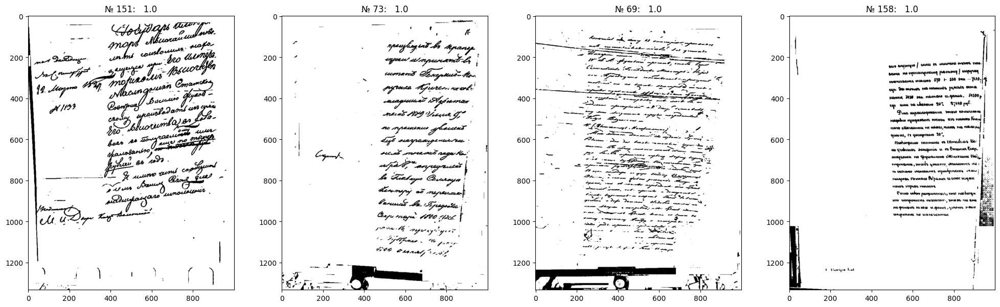

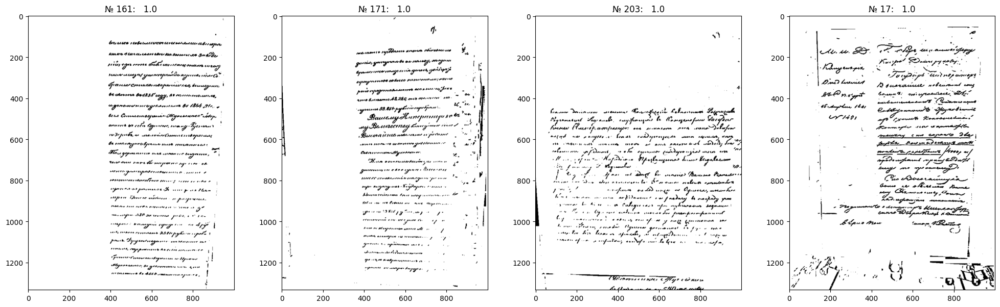

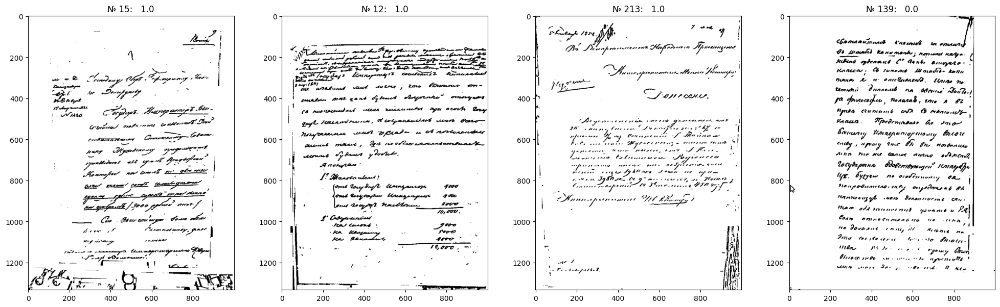

...

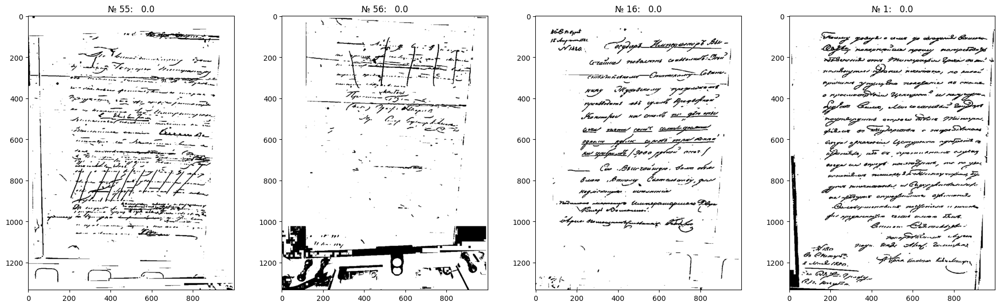

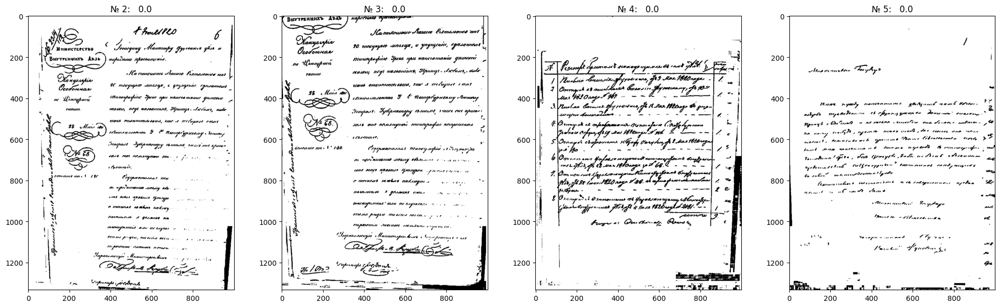

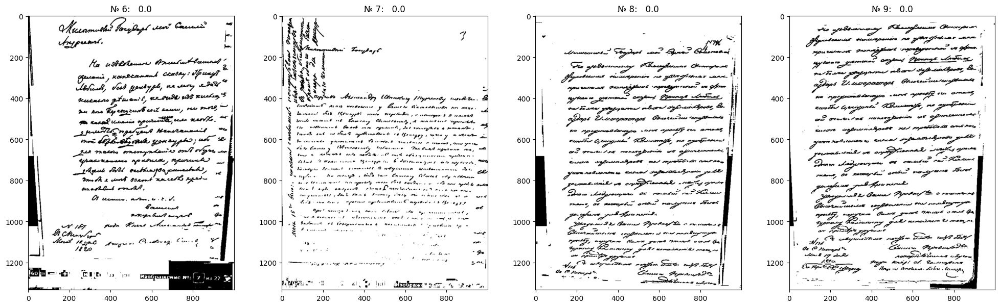

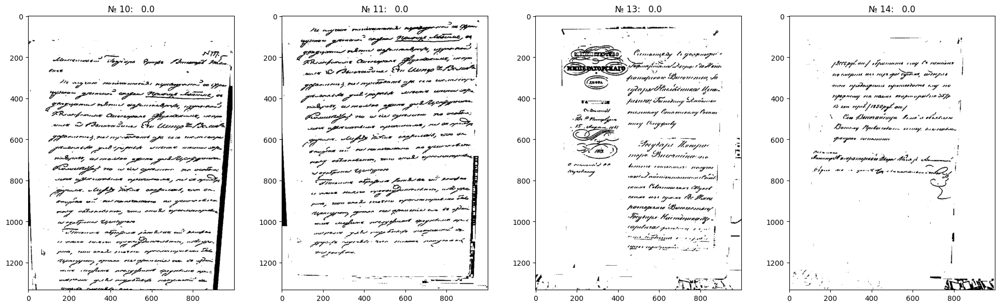

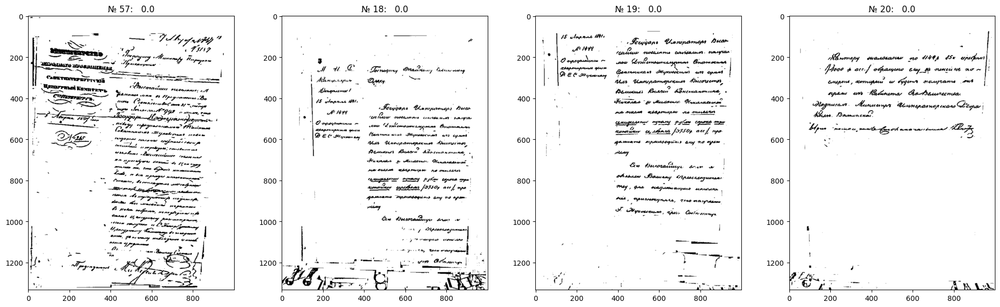

In [ ]:
show_best("bin/0res", model, neg_dataset, 10, CONF1.loader.batch_size, CONF1.device)

# IAM

In [ ]:
CONF1 = hydra_config("config (AIM).yaml")
show_CONF(CONF1)

{
        "seed": 42,
        "device": "cuda",
        "save_path": "checkpoints",
        "loader": {
                "batch_size": 64
        },
        "siamese": {
                "n_epochs": 100,
                "learning_rate": 0.0003,
                "margin": 9,
                "path_model": "checkpoints/siam_aim",
                "path_log": "checkpoints/siam_aim/siam_aim.pickle"
        },
        "classifier": {
                "n_epochs": 50,
                "learning_rate": 0.0003,
                "path_model": "checkpoints/cl_aim",
                "path_log": "checkpoints/cl_aim/cl_aim.pickle"
        }
}


In [ ]:
dataset_train = datasets.ImageFolder('dataset_min_train', transform=transforms.Compose(
        [   transforms.ToTensor(),
            v2.functional.grayscale_to_rgb,
            transforms.Resize(300),
            transforms.CenterCrop(224)
        ]))


dataset_test = datasets.ImageFolder('dataset_min_test', transform=transforms.Compose(
        [   transforms.ToTensor(),
            v2.functional.grayscale_to_rgb,
            transforms.Resize(300),
            transforms.CenterCrop(224)
        ]))

In [ ]:
from collections import defaultdict

class TripletMultiDataset(Dataset):
    def __init__(self, dataset, required_len, min_col=5, deterministic=True, seed=42):
        self.dataset = dataset
        self.required_len = required_len
        self.deterministic = deterministic

        self.cls2idx = defaultdict(list)

        for idx, (pic, cls) in tqdm(enumerate(dataset)):
            self.cls2idx[cls].append(idx)
            # print(self.cls2idx)

        # self.cls2idx = cls2idx

        cls2idx_list = [[] for i in range(len(self.cls2idx))]
        for i, _ in enumerate(cls2idx_list):
            cls2idx_list[i] = self.cls2idx[i]

        self.cls2idx = cls2idx_list

        if self.deterministic:
            seed_everything(seed)
            self.X = []

            for i in tqdm(range(self.required_len)):

                cls = random.randrange(len(self.cls2idx))
                idxs = self.cls2idx[cls]
                if len(idxs) > 1:
                    anchor, positive = random.sample(idxs, 2)
                else:
                    anchor, positive = idxs[0], idxs[0]
                anchor, positive = self.dataset[anchor][0], self.dataset[positive][0]

                clss = self.cls2idx[:cls] + self.cls2idx[cls+1:]
                idxs = random.choice(clss)
                negative = random.choice(idxs)
                negative = self.dataset[negative][0]

                l = [anchor, positive, negative]

                self.X.append(l)


    def __len__(self):
        return self.required_len

    def __getitem__(self, idx):
        if idx < len(self):

            if self.deterministic:
                # anchor, positive, negative = self.X[idx]
                # return self.dataset[anchor][0], self.dataset[positive][0], self.dataset[negative][0]
                return self.X[idx]
            else:
                pass
        else:
            raise IndexError

In [ ]:
dataset_tri_train = TripletMultiDataset(dataset_train, required_len=800)

torch.save(dataset_tri_train, 'dataset_tri_train.pt')

dataset_tri_test = TripletMultiDataset(dataset_test, required_len=200)

torch.save(dataset_tri_test, 'dataset_tri_test.pt')

336it [02:58,  1.88it/s]
100%|██████████| 800/800 [00:39<00:00, 20.05it/s]
61it [00:32,  1.85it/s]
100%|██████████| 200/200 [00:14<00:00, 13.87it/s]


In [ ]:
# anchor, positive, negative = dataset_tri_train.X[0]
# anchor

In [ ]:
dataset_tri_train = torch.load('dataset_tri_train.pt')
dataset_tri_test = torch.load('dataset_tri_test.pt')

In [ ]:
from time import gmtime, strftime, time

def load_best_model(CONF, model, train_dataset, test_dataset, kind):
    print("load_best_model:")
    conf = config_model(CONF, model, kind)

    log = f"# {{}} Epoch {{:{len(str(conf.n_epochs))}}} "
    log += f"train/val: loss {{:6.5f}}/{{:6.5f}}, acc:{{:7.3f}}%/{{:7.3f}}%"

    logs = load_logs(conf.path_log)
    idx = np.array(logs["val_loss"]).argmin()
    best_epoch = logs["epoch"][idx]

    params = (
        strftime("%Y-%m-%d %H:%M:%S", gmtime(time())),
        best_epoch,
        logs["train_loss"][idx],
        logs["val_loss"][idx],
        logs["train_accuracy"][idx],
        logs["val_accuracy"][idx],
    )
    print("LOGS:")
    print(log.format(*params))

    load_model(model, best_epoch, conf.path_model, CONF.device)

    if train_dataset is not None and test_dataset is not None:

        train_loader = DataLoader(
            train_dataset, batch_size=CONF.loader.batch_size, shuffle=False
        )
        val_loader = DataLoader(
            test_dataset, batch_size=CONF.loader.batch_size, shuffle=False
        )

        train_accuracy, train_loss = conf.eval_epoch(
            model, train_loader, conf.loss_fn, CONF.device
        )
        val_accuracy, val_loss = conf.eval_epoch(
            model, val_loader, conf.loss_fn, CONF.device
        )

        params = (
            strftime("%Y-%m-%d %H:%M:%S", gmtime(time())),
            best_epoch,
            train_loss,
            val_loss,
            train_accuracy * 100,
            val_accuracy * 100,
        )
        print("MODEL:")
        print(log.format(*params))

In [ ]:
siam = models.resnet18(weights=models.ResNet18_Weights.DEFAULT)
num_classes = 1000
num_non_freeze = 11689512
seed_everything(CONF1.seed)
siam = create_model(siam, num_non_freeze, num_classes).to(CONF1.device)
print(f"num parameters ResNet = {number_of_parameters(siam)}")
load_best_model(CONF1, siam, None, None, kind="siam")

num parameters ResNet = 11689512
load_best_model:
LOGS:
# 2024-06-21 13:01:08 Epoch   6 train/val: loss 0.03604/0.00000, acc: 99.875%/100.000%


num parameters ResNet = 11689512
train: started, kind = 'siam'
# 2024-06-21 12:27:36 Epoch   1 train/val: loss 0.36898/0.07271, acc: 99.625%/100.000%
# 2024-06-21 12:27:46 Epoch   2 train/val: loss 0.07810/0.04905, acc: 99.625%/100.000%
# 2024-06-21 12:27:57 Epoch   3 train/val: loss 0.00167/0.03294, acc:100.000%/100.000%
# 2024-06-21 12:28:08 Epoch   4 train/val: loss 0.03338/0.01524, acc:100.000%/100.000%
# 2024-06-21 12:28:18 Epoch   5 train/val: loss 0.05210/0.01172, acc:100.000%/100.000%
# 2024-06-21 12:28:29 Epoch   6 train/val: loss 0.03604/0.00000, acc: 99.875%/100.000%
# 2024-06-21 12:28:40 Epoch   7 train/val: loss 0.00947/0.01151, acc:100.000%/100.000%
# 2024-06-21 12:28:51 Epoch   8 train/val: loss 0.09204/0.00576, acc:100.000%/100.000%
# 2024-06-21 12:29:02 Epoch   9 train/val: loss 0.05922/0.20899, acc: 99.875%/ 98.500%
# 2024-06-21 12:29:13 Epoch  10 train/val: loss 0.05682/0.05776, acc:100.000%/ 99.500%
# 2024-06-21 12:29:23 Epoch  11 train/val: loss 0.07609/0.01599, ac

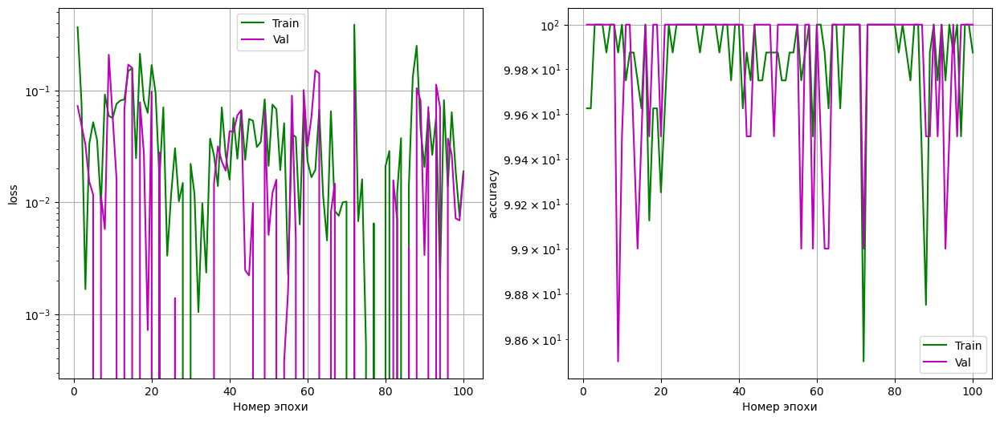

In [ ]:
siam = models.resnet18(weights=models.ResNet18_Weights.DEFAULT)
num_classes = 1000
num_non_freeze = 11689512
seed_everything(CONF1.seed)
siam = create_model(siam, num_non_freeze, num_classes).to(CONF1.device)
print(f"num parameters ResNet = {number_of_parameters(siam)}")

seed_everything(CONF1.seed)
common_train(CONF1, siam, dataset_tri_train, dataset_tri_test, kind="siam")
load_best_model(CONF1, siam, dataset_tri_train, dataset_tri_test, kind="siam")
logs = load_logs(CONF1.siamese.path_log)
graph_logs(logs, num=0)

In [ ]:
class Emb_Dataset(Dataset):
    def __init__(self, model, dataset):
        dataloader = DataLoader(dataset, batch_size=CONF1.loader.batch_size, shuffle=False)
        prob_items = []
        true_items = []

        with torch.no_grad():
            for batch in tqdm(dataloader):
                X_batch, y_batch = batch

                true_items.append(y_batch)
                logits = model(X_batch.to(CONF1.device))

                prob_items.append(logits)

        prob_items = torch.cat(prob_items)
        true_items = torch.cat(true_items)

        self.prob_items = prob_items
        self.true_items = true_items

    def __len__(self):
        return len(self.prob_items)

    def __getitem__(self, idx):
        if idx < len(self):
            return self.prob_items[idx], self.true_items[idx]
        else:
            raise IndexError

num parameters = 532519


100%|██████████| 1/1 [00:00<00:00,  1.13it/s]


train: started, kind = 'cl'
# 2024-06-21 13:01:18 Epoch  1 train/val: loss 2.59417/2.69282, acc: 44.940%/ 45.902%
# 2024-06-21 13:01:18 Epoch  2 train/val: loss 2.00257/2.25023, acc: 50.000%/ 39.344%
# 2024-06-21 13:01:18 Epoch  3 train/val: loss 1.55155/2.00695, acc: 60.417%/ 39.344%
# 2024-06-21 13:01:18 Epoch  4 train/val: loss 1.25929/1.80941, acc: 70.536%/ 40.984%
# 2024-06-21 13:01:18 Epoch  5 train/val: loss 0.97871/1.67600, acc: 80.655%/ 44.262%
# 2024-06-21 13:01:18 Epoch  6 train/val: loss 0.85036/1.60204, acc: 86.607%/ 47.541%
# 2024-06-21 13:01:18 Epoch  7 train/val: loss 0.72508/1.64936, acc: 86.905%/ 40.984%
# 2024-06-21 13:01:18 Epoch  8 train/val: loss 0.62594/1.67136, acc: 88.988%/ 39.344%
# 2024-06-21 13:01:18 Epoch  9 train/val: loss 0.56452/1.62687, acc: 91.071%/ 50.820%
# 2024-06-21 13:01:18 Epoch 10 train/val: loss 0.49348/1.58081, acc: 92.560%/ 47.541%
# 2024-06-21 13:01:18 Epoch 11 train/val: loss 0.42305/1.59373, acc: 94.643%/ 47.541%
# 2024-06-21 13:01:18 Epoc

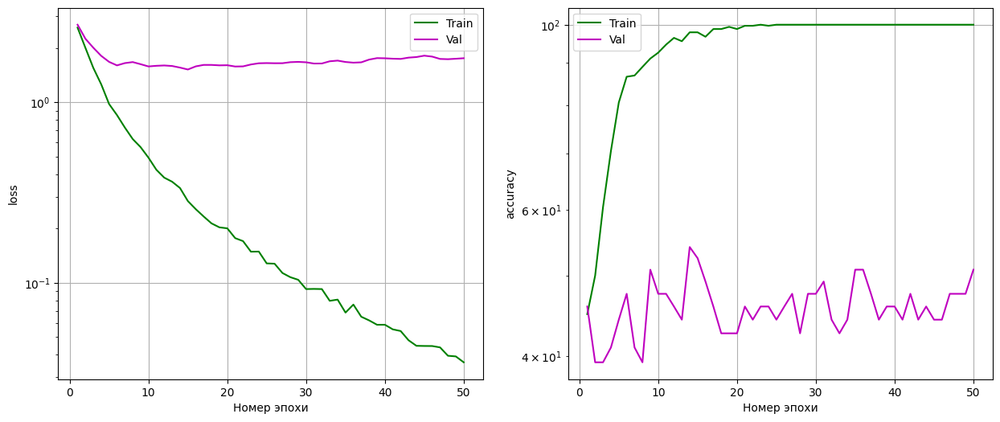

In [ ]:
cl = nn.Sequential(nn.Linear(num_classes, 512), nn.ReLU(), nn.Linear(512, 39)).to(
    CONF1.device
)

num_param = number_of_parameters(cl)
print(f"num parameters = {num_param}")

dataset_emb_train = Emb_Dataset(siam, dataset_train)
dataset_emb_test = Emb_Dataset(siam, dataset_test)

seed_everything(CONF1.seed)
# train_dataset, test_dataset = split_dataset(dataset_emb)

common_train(CONF1, cl, dataset_emb_train, dataset_emb_test, kind="cl")
load_best_model(CONF1, cl, dataset_emb_train, dataset_emb_test, kind="cl")
logs = load_logs(CONF1.classifier.path_log)
graph_logs(logs, num=0)

model = Pipeline(siam, cl, CONF1)